## Advanced Lane Finding Project
## by Reinaldo Maslim

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## Undistorting camera image calibration

First the object points in 3D cartesian coordinate of the chessboard has to be given, with the assumption of the chessboard on x-y plane with z=0. As the same chessboard is used for all images, the obj points are the same for all test images. Then for each image, using the cv2.findChessboardCorners() function to provide corners of each grid in the chessboard. Combining both object points and corners for all images in two lists, we then feed these lists to calibrateCamera() function to compute camera calibration and distortion coefficients. Afterwards, subsequent images can be corrected by undistort() function.

In [54]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        #cv2.imshow('img',img)
        #cv2.waitKey(500)

cv2.destroyAllWindows()


ret, mtx, dist, rvecs, tvecs=cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
#gray.shape[::-1] returns image height and width like 960, 1280. can also be img.shape[0:2]
#dist:distortion coeff, mtx:camera matrix 3D-2D, rvecs-tvecs: rotation and translation vectors from world to image

dst=cv2.undistort(img, mtx, dist, None, mtx)

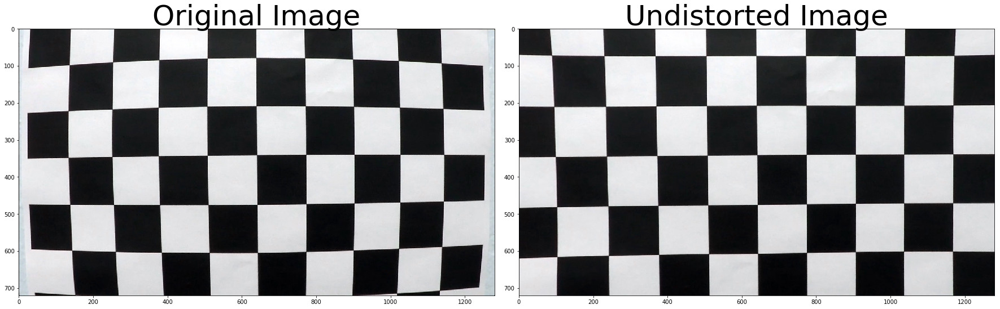

In [55]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
img = cv2.imread('./camera_cal/calibration1.jpg')
dst=cv2.undistort(img, mtx, dist, None, mtx)
#cv2.imwrite('./camera_cal/undist1.jpg',dst)
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Create thresholded binary image

I used color transform the images into HLS color space. By using the saturation S-channel, a binary image is formed by thresholding the colors in this channel. On the other hand, I also performed Sobel along x-axis to grayscale image to preserve vertical gradient lines and eliminate horizontal lines. 

These two binary images are combined together as an input to the next pipeline.

In [56]:
def undistort(image_raw):
    
    image=cv2.undistort(image_raw, mtx, dist, None, mtx)

    return image

In [101]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return binary_output

def mag_thresh(image, sobel_kernel=3, mag_thresh=(0, 255)):
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray=cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately

    abs_sobelx = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    
    abs_sobely = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    # 3) Calculate the magnitude
    abs_sobelxy=np.sqrt(np.add(np.square(abs_sobelx), np.square(abs_sobely)))
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    
    # 5) Create a binary mask where mag thresholds are met
    # 6) Return this mask as your binary_output image
    scaled_sobel = np.uint8(255*abs_sobelxy/np.max(abs_sobelxy))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1]) ]= 1
    return binary_output

def dir_threshold(image, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Apply the following steps to img
    # 1) Convert to grayscale
    
    # 2) Take the gradient in x and y separately
    # 3) Take the absolute value of the x and y gradients
    gray=cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    abs_sobelx = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    abs_sobely = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    grad=np.arctan2(abs_sobely, abs_sobelx)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    # 5) Create a binary mask where direction thresholds are met
    # 6) Return this mask as your binary_output image
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(grad)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(grad >= thresh[0]) & (grad <=thresh[1]) ]= 1
    return binary_output


def get_combined_color(img):

    s_channel = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)[:,:,2]
    
    l_channel = cv2.cvtColor(img, cv2.COLOR_BGR2LUV)[:,:,0]

    b_channel = cv2.cvtColor(img, cv2.COLOR_BGR2Lab)[:,:,2]   

    # Threshold color channel
    s_thresh_min = 150
    s_thresh_max = 200
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1
    
    b_thresh_min = 155
    b_thresh_max = 200
    b_binary = np.zeros_like(b_channel)
    b_binary[(b_channel >= b_thresh_min) & (b_channel <= b_thresh_max)] = 1
    
    l_thresh_min = 225
    l_thresh_max = 255
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh_min) & (l_channel <= l_thresh_max)] = 1

    #color_binary = np.dstack((u_binary, s_binary, l_binary))
    
    color_binary = np.zeros_like(s_binary)
    color_binary[(l_binary == 1) | (b_binary == 1)| (s_binary==1)] = 1   
    
    
    return color_binary


##  Region of interest masking and perspective transform

Perpective transform is applied using a warp() function with image input. The source src and destination dst polygon is hardcoded as follows:

```
    src=np.float32(
        [[image.shape[1]/2-100, image.shape[0]-270],
        [image.shape[1]/2+100, image.shape[0]-270],
        [image.shape[1]/2+650, image.shape[0]],
        [image.shape[1]/2-650, image.shape[0]]])

    dst=np.float32([
        [image.shape[1]*1/7, 0],
        [image.shape[1]*6/7, 0],
        [image.shape[1]*6/7, image.shape[0]],
        [image.shape[1]*1/7, image.shape[0]]])

```

The perpective transform is verified by checking that straight road will correspond to straight vertical lines on the warped image. Additionally, I mask the warped image by region_of_interest() function that removes pixels information outside this polygon. The vertices of this polygon is set as:

```
    vertices = np.array([[(img.shape[1]/2-80, img.shape[0]-280),
            (img.shape[1]/2+80, img.shape[0]-280),
            (img.shape[1]/2+670, img.shape[0]),
            (img.shape[1]/2-670, img.shape[0])]], dtype=np.int32)
  
```
By doing this, we eliminate bushes or walls that lies close to the lane lines.

In [100]:
def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 1

    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def warp(img):
    global N, Ninv
    img_size=(img.shape[1], image.shape[0])
    
    src=np.float32(
        [[image.shape[1]/2-100, image.shape[0]-270],
        [image.shape[1]/2+100, image.shape[0]-270],
        [image.shape[1]/2+650, image.shape[0]],
        [image.shape[1]/2-650, image.shape[0]]])
    
    dst=np.float32([
        [image.shape[1]*1/7, 0],
        [image.shape[1]*6/7, 0],
        [image.shape[1]*6/7, image.shape[0]],
        [image.shape[1]*1/7, image.shape[0]]])
    
    N=cv2.getPerspectiveTransform(src, dst)

    Ninv=cv2.getPerspectiveTransform(dst, src)

    warped=cv2.warpPerspective(img, N, img_size, flags=cv2.INTER_LINEAR)
    
    return warped



## Identifying lane line pixels and fitting polynomial

To identify lane-line pixels, sliding window is adopted with 9 windows with width expanded size of margin to left and right. First, the starting positions of window is determined from left and right peaks of histogram along x-axis summed from lower 30% of the image. If sufficient number of pixels are inside this window, then we recenter the window. Both windows are propagated upwards while recentering to the mean x-value at every steps. 

After pixels belonging to both lanes are found, polyfit function is applied to obtain a 2nd order polynomial for each lane. 

In [127]:
def blind_search(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom 0.3 of the image
    histogram = np.sum(binary_warped[np.int(0.7*binary_warped.shape[0]):,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped)).astype(np.uint8)*255
    #print(np.max(out_img))
    #plt.imshow(out_img)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    pointfour = np.int(0.4*histogram.shape[0])
    pointsix=np.int(0.6*histogram.shape[0])
    leftx_base = np.argmax(histogram[:pointfour]) #get the peak from first half(left)
    rightx_base = np.argmax(histogram[pointsix:]) + pointsix #get peak from secondhalf(right)
    
    # Choose the number of sliding windows
    nwindows = 9 
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin =  100
    # Set minimum number of pixels found to recenter window
    minpix = 30
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]


    return left_fit, right_fit, left_fitx, right_fitx, out_img
    


## Computing radius of curvature and position of car from the center

Radius of curvature of each lane can be computed from the resulting polynomial. As both polynomials previously fitted is in pixels unit, we have to convert it into meters by these corresponding conversions.

```
    y-axis
    720 pixels = 30 m

    x-axis
    700 pixels = 3.7 m
```

Therefore, the radius of curvature can be obtained as:
```
    radius = ((1 + (2*fit_curve[0]*y_eval + fit_curve[1])**2)**1.5)/np.absolute(2*fit_curve[0])
```

Meanwhile, the position of car from the center can also be calculated by comparing the mid section of left-right lanes to the image center. Similarly, we have to convert px units to m.


```
    position = image.shape[1]/2
    left  = np.min(pts[(pts[:,1] < position) & (pts[:,0] > 700)][:,1])
    right = np.max(pts[(pts[:,1] > position) & (pts[:,0] > 700)][:,1])
    center = (left + right)/2
    # Define conversions in x and y from pixels space to meters
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension

    offset_from_center=(position - center)*xm_per_pix

```

In [96]:
def find_radius(ploty, fitx):
    
    y_eval = np.max(ploty)/2
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension
    
    fit_curve = np.polyfit(ploty*ym_per_pix, fitx*xm_per_pix, 2)
    radius = ((1 + (2*fit_curve[0]*y_eval + fit_curve[1])**2)**1.5)/np.absolute(2*fit_curve[0])
    
    return radius

def find_centre(pts):
    # Find the position of the car from the center
    # It will show if the car is 'x' meters from the left or right
    position = image.shape[1]/2
    left  = np.min(pts[(pts[:,1] < position) & (pts[:,0] > 500)][:,1])
    right = np.max(pts[(pts[:,1] > position) & (pts[:,0] > 500)][:,1])
    
    
    center = (left + right)/2
    # Define conversions in x and y from pixels space to meters
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension
    
    return (position - center)*xm_per_pix

In [97]:
def draw_poly(image, binary_warped, left_fitx, right_fitx):
    y_len=720
    ploty = np.linspace(0, y_len-1, y_len)
    # Draw green lane onto original image
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane as green onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255,0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Ninv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undistort(image), 1, newwarp, 0.3, 0)

    left_curverad=find_radius(ploty, left_fitx)
    right_curverad=find_radius(ploty, right_fitx)
    
    pts = np.argwhere(newwarp[:,:,1])
    position=find_centre(pts)
    font = cv2.FONT_HERSHEY_SIMPLEX
    
    text="Left curve %f, right curve %f" %(left_curverad,right_curverad)
    cv2.putText(result,text,(100,100), font, 1, (255,255,255), 2)
    
    if position < 0:
        text = "Vehicle is {:.2f} m left of center".format(-position)
    else:
        text = "Vehicle is {:.2f} m right of center".format(position)
    result=cv2.putText(result, text, (100, 50), font,  1, (255,255,255), 2)
    
    return result

In [98]:
def prepare(image_raw):
    image=cv2.undistort(image_raw, mtx, dist, None, mtx)
    kernel_size = 5
    img = cv2.GaussianBlur(image, (kernel_size, kernel_size), 0)
    # Convert to HLS color space and separate the S channel
    ksize=5
    sxbinary=abs_sobel_thresh(img, thresh=(20, 100))
    gradx = abs_sobel_thresh(img, orient='x', sobel_kernel=ksize, thresh=(20, 120))
    grady = abs_sobel_thresh(img, orient='y', sobel_kernel=ksize, thresh=(60, 255))
    mag_binary = mag_thresh(img, sobel_kernel=ksize, mag_thresh=(40, 255))
    dir_binary = dir_threshold(img, sobel_kernel=ksize, thresh=(.65, 1.05))

    # Combine all the thresholding information
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1

    combined_color=get_combined_color(img)

    combined_binary=np.zeros_like(combined)
    combined_binary[(combined_color > 0) | (combined > 0)] = 1

    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different colors
    #green is combined gradient_thresh, blue is s_binary
    color_binary = np.dstack((np.zeros_like(gray), combined, combined_color))

    vertices = np.array([[(img.shape[1]/2-80, img.shape[0]-280),
            (img.shape[1]/2+80, img.shape[0]-280),
            (img.shape[1]/2+670, img.shape[0]),
            (img.shape[1]/2-670, img.shape[0])]], dtype=np.int32)

    masked_img=region_of_interest(combined_binary, vertices)
    
    warped_img=np.absolute(warp(masked_img))
    
    return warped_img

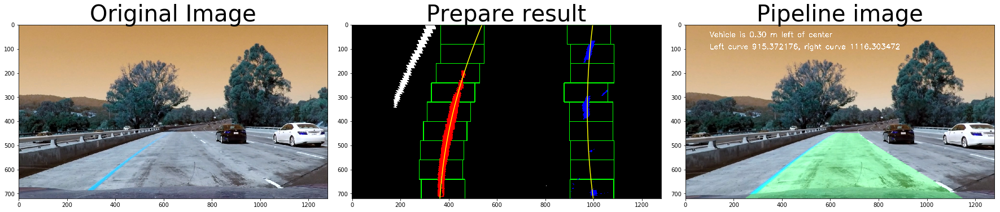

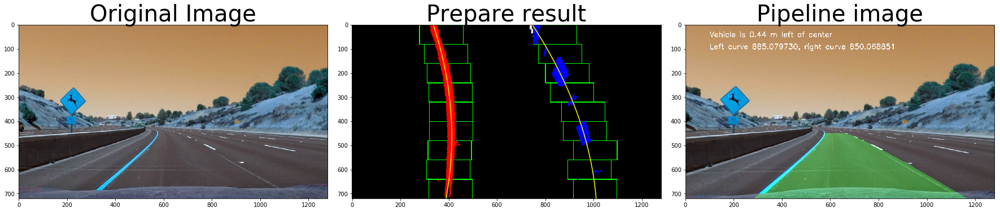

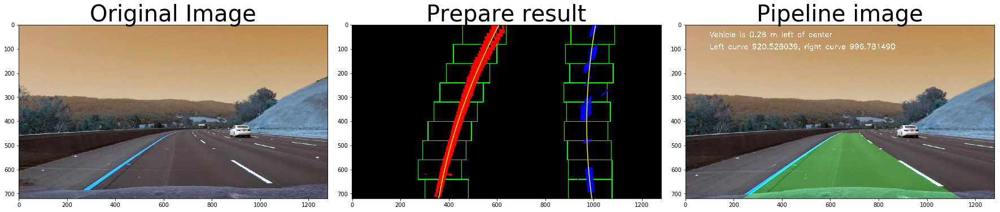

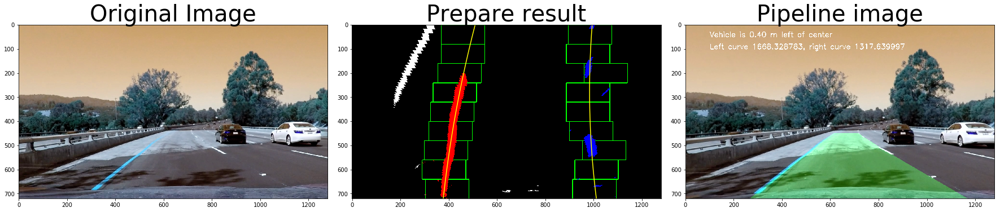

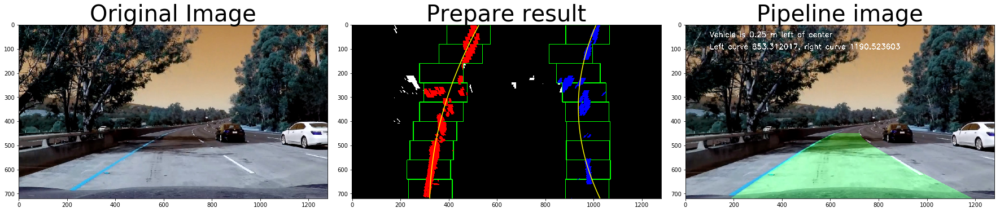

...

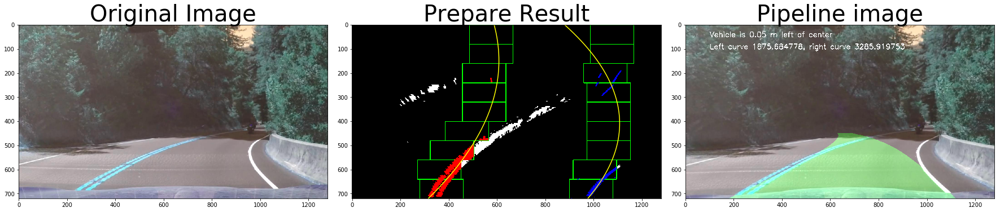

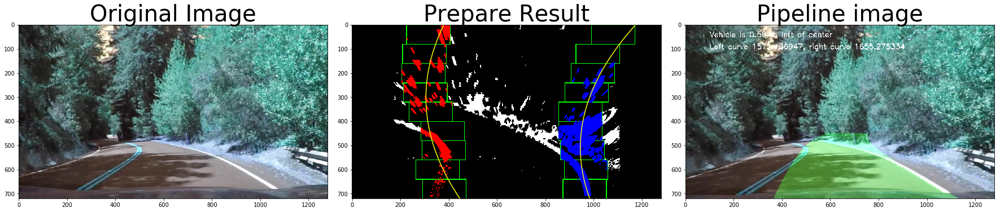

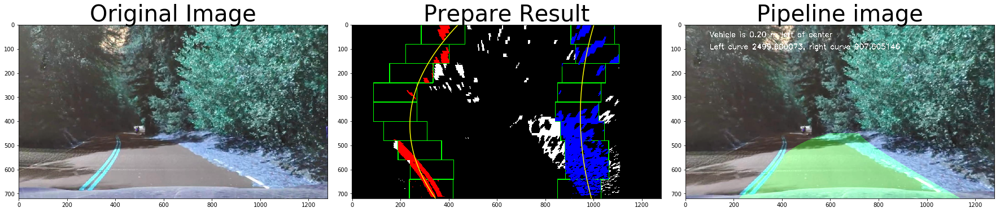

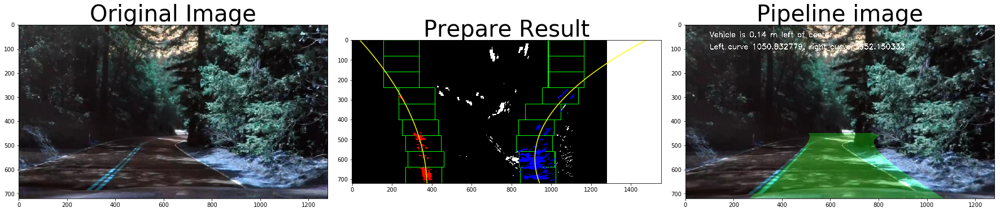

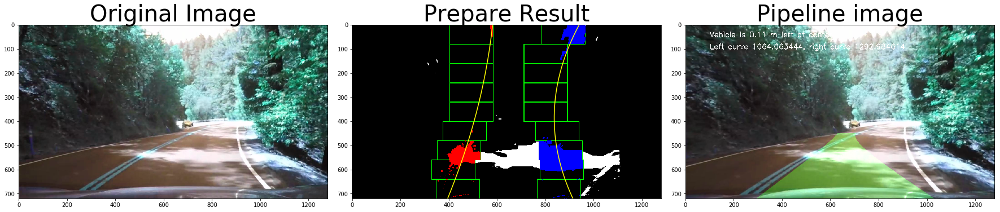

In [63]:
#Test prepare() function and pipeline()

y_len=720
ploty = np.linspace(0, y_len-1, y_len)

for i in range(1,6):
    fname = './test_images/test{}.jpg'.format(i)
    image = cv2.imread(fname)
    image= cv2.resize(image, (1280, 720)) 
    result = prepare(image)
    _, _, left_fitx, right_fitx, out_img=  blind_search(result)  
    
    
    # Plot the result
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    #print(np.max(image))
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(out_img)
    ax2.plot(left_fitx, ploty, color='yellow')
    ax2.plot(right_fitx, ploty, color='yellow')
    #ax2.xlim(0, img.shape[1])
    #ax2.ylim(img.shape[0], 0)
    
    ax2.set_title('Prepare result', fontsize=40)
 
    ax3.imshow(draw_poly(image, result, left_fitx, right_fitx))
    #ax3.imshow(out_img)
    ax3.set_title('Pipeline image', fontsize=40)
   
   
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
for i in range(1,11):
    fname = './test_images/hard{}.jpg'.format(i)
    image = cv2.imread(fname)
    image= cv2.resize(image, (1280, 720)) 
    result = prepare(image)
    _, _, left_fitx, right_fitx, out_img= blind_search(result)  
    

    # Plot the result
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    #print(np.max(image))
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(out_img)
    ax2.plot(left_fitx, ploty, color='yellow')
    ax2.plot(right_fitx, ploty, color='yellow')
    #ax2.xlim(0, img.shape[1])
    #ax2.ylim(img.shape[0], 0)
    
    ax2.set_title('Prepare Result', fontsize=40)
    
    ax3.imshow(draw_poly(image, result, left_fitx, right_fitx))
    ax3.set_title('Pipeline image', fontsize=40)
 
   
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    


In [64]:
#Normal pipeline without considering previous frames

def pipeline(image):
    
    prepared_result=prepare(image)
    _, _, left_fitx, right_fitx, _=  blind_search(prepared_result) 
    
    result=draw_poly(image, prepared_result, left_fitx, right_fitx)
    
    return result
    

## Advanced pipeline

In order to eliminate false lanes, lanes information from the previous frames can be utilized to predict, smoothen, and check current lanes. To do this, line class is defined to store information for left and right lanes. 

The class holds several important variables of the previous frames' lanes and setters functions to update variables.

In [119]:
# Define a class to receive the characteristics of each line detection
class Line():
    #lanes polynomials are in pixels
    def __init__(self):
        #number of iterations to be averaged
        self.n_iterations=30
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line, size=n x image.shape[0]
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations, size= image.shape[0]
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #counter for sanity
        self.sanity_count=0
        
    def setRecentXFitted(self, recent_xfitted):
        self.recent_xfitted = recent_xfitted
        
    def setBestX(self, bestx):
        self.bestx = bestx        

    def setBestFit(self, best_fit):
        self.best_fit = best_fit
        
    def setCurrentFit(self, current_fit):
        self.current_fit = current_fit
        
    def setRadius(self, radius_of_curvature):
        self.radius_of_curvature = radius_of_curvature
        
    def setDetected(self, detected):
        self.detected = detected
        
    def setSanityCount(self, sanity_count):
        self.sanity_count = sanity_count
        
print("line class is defined")

line class is defined


## Sanity check

Sanity check consist of three layers, namely:

1. Curvature similarity: 
    comparing radius of curvature of current to previous lane

2. Offset from lane: 
    thresholding error between curvature centroids of current and previous lane

3. Parallelness to previous best fit: 
    calculate mean squared error between current and previous lane

## Smoothen and update lane

If a new lane is detected, update lane parameters. Calculate the smoothened lane by averaging curve points over the last n iterations, then fit a polynomial to this averaged curve. 

If no new lane is detected, use old best polynomial averaged over last n iterations.

In [66]:
#define necessary auxillary functions

def check_sanity(lane, fitx):
    if lane.radius_of_curvature is None:
        #newly reset line
        return True
    
    ploty = np.linspace(0, len(fitx)-1, len(fitx))
    
    curve_threshold=[0.5, 2]
    horizontal_threshold=0.8
    mse_threshold=3000
    
    #check for curvature similarity
    current_radius=find_radius(ploty, fitx)
    #print("----")
    #print(current_radius)
    #print(lane.radius_of_curvature)
    #print("----")
    if (abs(current_radius/lane.radius_of_curvature)<curve_threshold[1] and abs(current_radius/lane.radius_of_curvature)>curve_threshold[0]) and (current_radius<5000 and current_radius>300):
        #similar curvature
        mid_position = image.shape[1]/2
        xm_per_pix = 3.7/700 # meteres per pixel in x dimension

        #check horizontal distance
        if abs(np.mean(fitx)-np.mean(lane.bestx))*xm_per_pix<horizontal_threshold:
            #separated correctly
            #check if roughly parallel
            mse = ((fitx - lane.bestx) ** 2).mean(axis=0)
            #print("mse")
            #print(mse)
            if mse<mse_threshold:
                #good fit
                return True
            else:
                #print("not parallel")
                #not parallel enough
                return False
        else:
            #print("too far offset")
            #too far offset
            return False
    else:
        #print("dissimilar curvature")
        #dissimilar curvature
        return False
    
    
def update_and_smoothen(lane, detected, newx):
    #newx is fitx result from look_ahead_search or blind_search if detected lane is sane
    y_len=720
    ploty = np.linspace(0, y_len-1, y_len)
    
    #update detected status, detected also means sane
    lane.setDetected(detected)
    
    if detected:
        #update lane parameters
        if len(lane.recent_xfitted)>=lane.n_iterations:
            #remove the first x_set on the list
            lane.recent_xfitted.pop(0)
        #add the newest x_set to the back
        lane.recent_xfitted.append(newx)
        
        lane.setRecentXFitted(lane.recent_xfitted)
        
        #using the latest n x values, update bestx as mean along axis-0 
        lane.bestx=np.mean(np.asarray(lane.recent_xfitted), 0)
        lane.setBestX(lane.bestx)
        #from bestx calculate best_fit polynomial coefficients
        lane.setBestFit(np.polyfit(ploty, lane.bestx, 2))
        smooth_fitx = lane.best_fit[0]*ploty**2 + lane.best_fit[1]*ploty + lane.best_fit[2]
        
        
        lane.setCurrentFit(np.polyfit(ploty, newx, 2))
        lane.setRadius(find_radius(ploty, smooth_fitx))
        
        return smooth_fitx
    else:
        old_smooth_fitx = lane.best_fit[0]*ploty**2 + lane.best_fit[1]*ploty + lane.best_fit[2]
        lane.setSanityCount(lane.sanity_count+1)
        
        return old_smooth_fitx
    

## Look ahead search

Once lanes are detected on the previous frame, we don't need to search blindly but instead search around these lanes. To perform this, I create a filter with margin offset from previous lane fit. Then, the binary birdview image is masked with this filter before performing blind_search() over this masked binary image. 

If either previous lane fits are not available, I did not mask the corresponding half.

In [67]:
def look_ahead_search(binary_warped, left_fit, right_fit):
    
    margin=75
    mask=np.zeros_like(binary_warped)
    #mask the image based on left and right polynomials
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
    
    if left_fit is not None:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
        left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
        left_line_pts = np.hstack((left_line_window1, left_line_window2))
        cv2.fillPoly(mask, np.int_([left_line_pts]), 1)
    else:
        mask[:, :int(mask.shape[1]/2)]=1
        
    if right_fit is not None:
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
        right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
        right_line_pts = np.hstack((right_line_window1, right_line_window2))
        cv2.fillPoly(mask, np.int_([right_line_pts]), 1)
    else:
        mask[:, int(mask.shape[1]/2):]=1

    
    masked_binary=cv2.bitwise_and(binary_warped, mask)
    
    #feed masked image to blind search
    left_fit, right_fit, left_fitx, right_fitx, _=blind_search(masked_binary)

    return left_fit, right_fit, left_fitx, right_fitx

## Get fit 

To get right and left fit, as their information are independent of another; sanity check, look ahead search, or blind search must be performed separately for each of them. The get_fit() function acts as decision making in all scenarios to use previous functions to get current lanes.

If lane on either side has not been detected for the past sane_threshold frames, the lane is reset as a new Line().

In [123]:
def get_fit(binary_warped, lane, mode):
    global left_lane, right_lane
    sane_threshold=15
    #mode 0=left, 1=right
    #print(lane.detected)
    if lane.detected is True:
        #if line previously detected
        #use look ahead search
        left_fit, right_fit, left_fitx, right_fitx=look_ahead_search(binary_warped, left_lane.best_fit, right_lane.best_fit)
        
        if mode==0:
            fitx=left_fitx
        else:
            fitx=right_fitx
            
        if check_sanity(lane, fitx):
            smoothen_fitx=update_and_smoothen(lane, True, fitx)
            #print("look ahead")
            return smoothen_fitx
        
        #use blind search 
        left_fit, right_fit, left_fitx, right_fitx, _=blind_search(binary_warped)
        
        if mode==0:
            fitx=left_fitx
        else:
            fitx=right_fitx
            
        if check_sanity(lane, fitx):
            smoothen_fitx=update_and_smoothen(lane, True, fitx)
            #print("blind")
            return smoothen_fitx
        #print("old")
        old_smoothen_fitx=update_and_smoothen(lane, False, None)
        return old_smoothen_fitx
    
    else:
        #if lane not detected previously
        if lane.sanity_count>sane_threshold:
            #reset line
            if mode==0:
                left_lane=Line()
            else:
                right_lane=Line()
        
        #use blind search 
        left_fit, right_fit, left_fitx, right_fitx, _=blind_search(binary_warped)
        
        if mode==0:
            fitx=left_fitx
        else:
            fitx=right_fitx
            
        if check_sanity(lane, fitx):
            smoothen_fitx=update_and_smoothen(lane, True, fitx)
            #print("blind")
            return smoothen_fitx
        
        #print("old")
        old_smoothen_fitx=update_and_smoothen(lane, False, None)
        return old_smoothen_fitx  

In [69]:
def advanced_pipeline(image):
    
    #prepare image by warping and masking into binary image
    binary_warped=prepare(image)
    
    left_fitx=get_fit(binary_warped, left_lane, 0)
    right_fitx=get_fit(binary_warped, right_lane, 1)
    
    
    result=draw_poly(image, binary_warped, left_fitx, right_fitx)
    
    return result
    

## Normal pipeline vs Advanced pipeline

The following cell outputs results from both normal pipeline and advanced pipeline(that takes previous frames into consideration). The images are sequenced with short time-steps for advanced pipeline to work. 

From the results, it is noticed that advance pipeline results in a smoother and stable than normal pipeline.

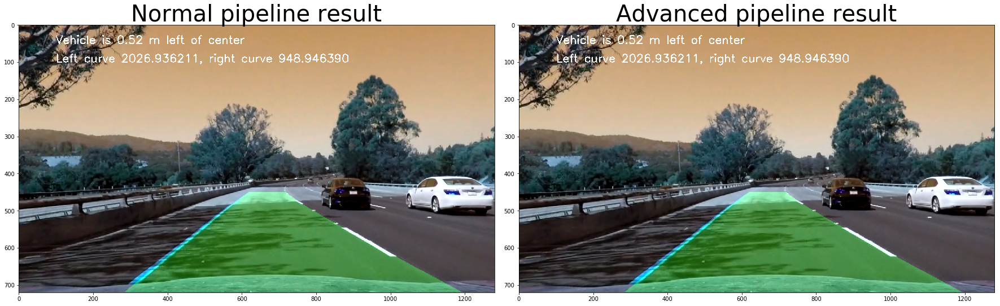

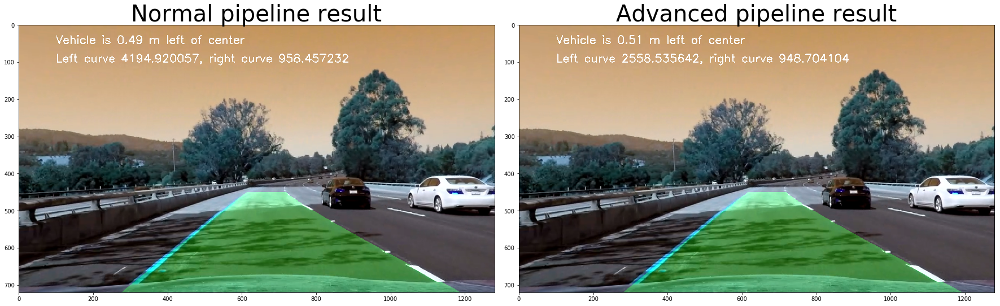

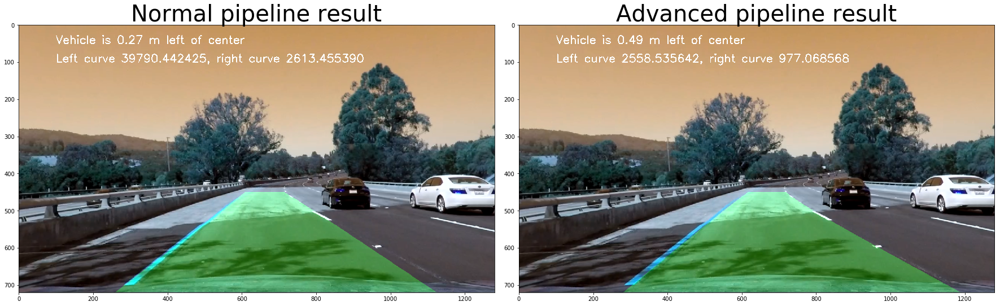

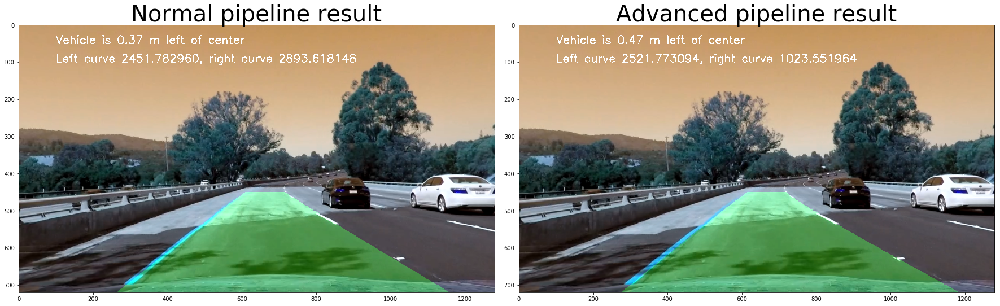

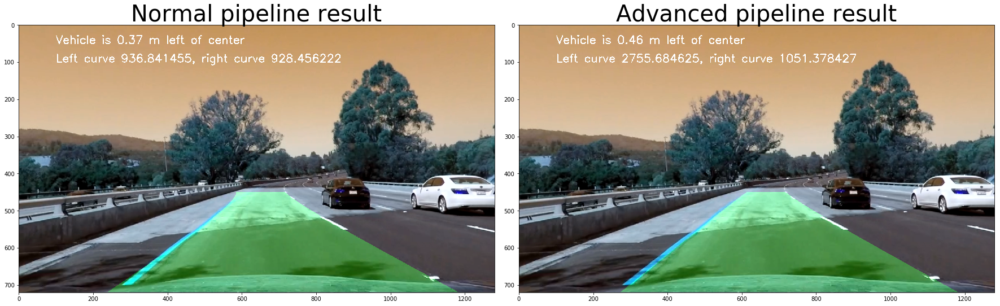

...

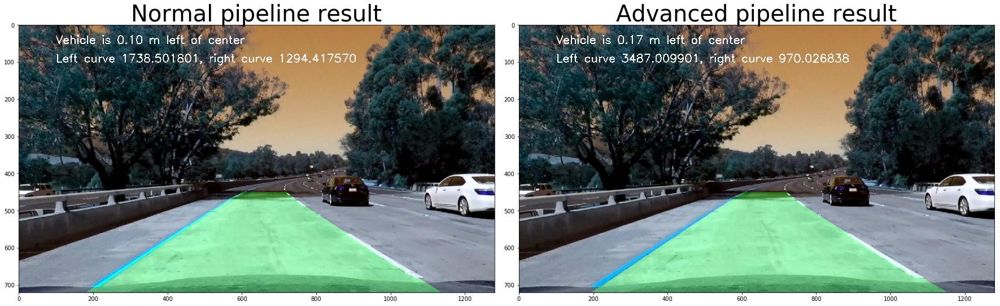

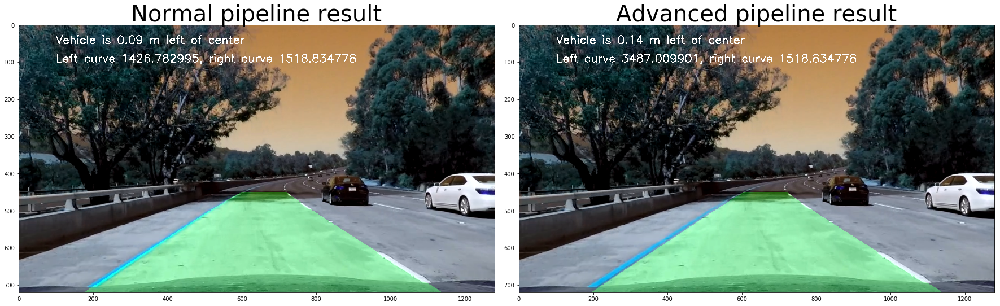

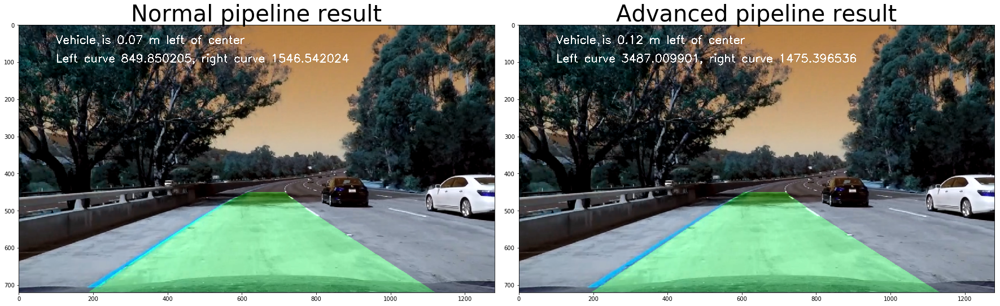

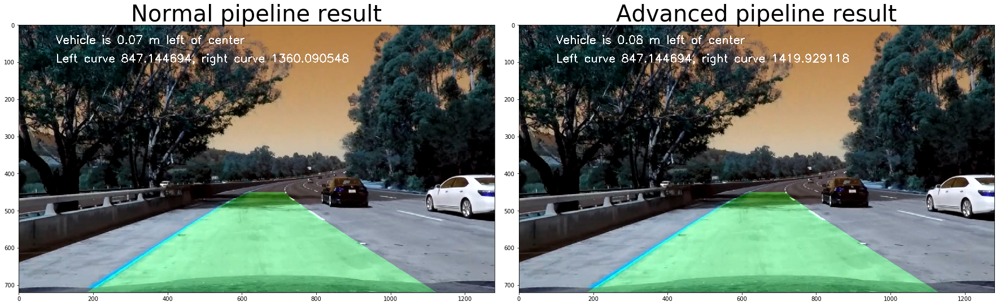

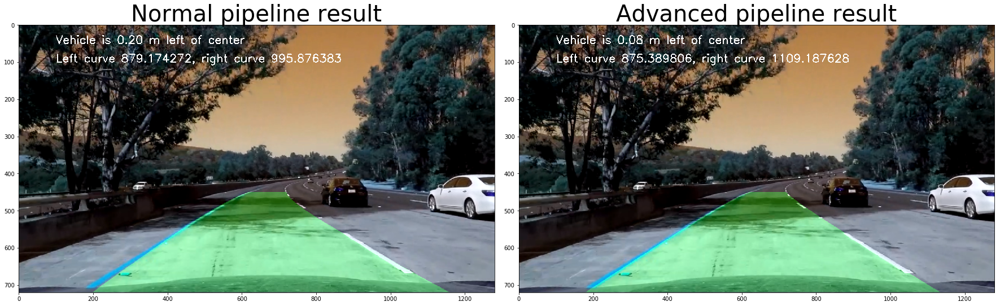

In [72]:
#reset lanes
left_lane=Line()
right_lane=Line()

for i in range(1,26):
    fname = './test_images/Screenshot from project_video.mp4 - {}.png'.format(i)
    image = cv2.imread(fname)
    #print(image.shape)
    image= cv2.resize(image, (1280, 720)) 

    # Plot the result
    f, (ax2, ax3) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    
    #ax1.imshow(image)
    #ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(pipeline(image))    
    ax2.set_title('Normal pipeline result', fontsize=40)
    
    ax3.imshow(advanced_pipeline(image))
    ax3.set_title('Advanced pipeline result', fontsize=40)
    
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    

    

## Generate result videos

First video: normal pipeline on project_video.mp4
Second video: advanced pipeline project_video.mp4
Third video: normal pipeline on challenge_video.mp4
Fourth video: advanced pipeline on challenge_video.mp4

In [75]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
mask_with_poly=False

In [76]:
project_output = './project_video_result_normal.mp4'
#clip1 = VideoFileClip("./project_video.mp4")
#project_clip = clip1.fl_image(pipeline) #NOTE: this function expects color images!!
#%time project_clip.write_videofile(project_output, audio=False)

In [77]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))

In [115]:
#reset lines
left_lane=Line()
right_lane=Line()

project_output = './project_video_result_advanced.mp4'
#clip1 = VideoFileClip("./project_video.mp4")
#project_clip = clip1.fl_image(advanced_pipeline) #NOTE: this function expects color images!!
#%time project_clip.write_videofile(project_output, audio=False)

In [105]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))

## Challenge video


In the section below, I attempted the challenge video with new sets of parameters (region_of_interest, warping, color thresholding, and Line() parameter). From trial and error, the results are shown in below as:

Normal pipeline:
challenge_video_result_normal.mp4

Advanced pipeline:
challenge_video_result_advanced.mp4

The normal pipeline outputs on an image sequence can also be seen below. Notice that the last image could not identify the right lane due to the abscence of detectable lane. 

From the videos, we can see that the advanced pipeline outputs a more reasonable and stable result.


In [106]:
def warp(img):
    global N, Ninv
    img_size=(img.shape[1], image.shape[0])
    
    src=np.float32(
        [[image.shape[1]/2-100, image.shape[0]-250],
        [image.shape[1]/2+100, image.shape[0]-250],
        [image.shape[1]/2+650, image.shape[0]],
        [image.shape[1]/2-650, image.shape[0]]])
    
    dst=np.float32([
        [image.shape[1]*1/7, 0],
        [image.shape[1]*6/7, 0],
        [image.shape[1]*6/7, image.shape[0]],
        [image.shape[1]*1/7, image.shape[0]]])
    
    N=cv2.getPerspectiveTransform(src, dst)

    Ninv=cv2.getPerspectiveTransform(dst, src)

    warped=cv2.warpPerspective(img, N, img_size, flags=cv2.INTER_LINEAR)
    
    return warped

def get_combined_color(img):

    s_channel = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)[:,:,2]
    
    l_channel = cv2.cvtColor(img, cv2.COLOR_BGR2LUV)[:,:,0]

    b_channel = cv2.cvtColor(img, cv2.COLOR_BGR2Lab)[:,:,2]   

    # Threshold color channel
    s_thresh_min = 80
    s_thresh_max = 230
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh_min) & (s_channel <= s_thresh_max)] = 1
    
    
    l_thresh_min = 200
    l_thresh_max = 255
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh_min) & (l_channel <= l_thresh_max)] = 1
    
    b_thresh_min = 155
    b_thresh_max = 200
    b_binary = np.zeros_like(b_channel)
    b_binary[(b_channel >= b_thresh_min) & (b_channel <= b_thresh_max)] = 1
    

    #color_binary = np.dstack((u_binary, s_binary, l_binary))
    
    color_binary = np.zeros_like(s_binary)
    color_binary[(l_binary == 1) | (b_binary == 1)| (s_binary==1)] = 1   
    
    
    return color_binary


#change mask
def prepare(image_raw):
    image=cv2.undistort(image_raw, mtx, dist, None, mtx)
    kernel_size = 5
    img = cv2.GaussianBlur(image, (kernel_size, kernel_size), 0)
    # Convert to HLS color space and separate the S channel
    ksize=5
    mag_binary = mag_thresh(img, sobel_kernel=ksize, mag_thresh=(40, 255))
    dir_binary = dir_threshold(img, sobel_kernel=ksize, thresh=(.20, 1.15))

    # Combine all the thresholding information
    combined = np.zeros_like(dir_binary)
    #combined[((gradx == 1) & (grady == 1))| ((mag_binary == 1) & (dir_binary == 1))] = 1
    combined[((mag_binary == 1) & (dir_binary == 1))] = 1
    combined_color=get_combined_color(img)

    combined_binary=np.zeros_like(combined)
    combined_binary[(combined_color > 0) | (combined > 0)] = 1

    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different colors
    #green is combined gradient_thresh, blue is s_binary
    color_binary = np.dstack((np.zeros_like(gray), combined, combined_color))

    vertices = np.array([[(img.shape[1]/2-20, img.shape[0]-270),
            (img.shape[1]/2+80, img.shape[0]-270),
            (img.shape[1]/2+520, img.shape[0]),
            (img.shape[1]/2-440, img.shape[0])]], dtype=np.int32)
    
    masked_img=region_of_interest(combined_binary, vertices)
    
    warped_img=np.absolute(warp(masked_img))
    
    #warped_img=np.absolute(warp(combined_binary))
    
    return warped_img

def pipeline(image):
    
    prepared_result=prepare(image)
    _, _, left_fitx, right_fitx,out_img=  blind_search(prepared_result) 
    
    result=draw_poly(image, prepared_result, left_fitx, right_fitx)
    
    #vertices = np.array([[(img.shape[1]/2-20, img.shape[0]-270),
    #        (img.shape[1]/2+80, img.shape[0]-270),
    #        (img.shape[1]/2+520, img.shape[0]),
    #        (img.shape[1]/2-440, img.shape[0])]], dtype=np.int32)
    
    #result=region_of_interest(image, vertices)
    #out_img = np.dstack((prepared_result,prepared_result, prepared_result)).astype(np.uint8)*255
    #result=out_img
    return result

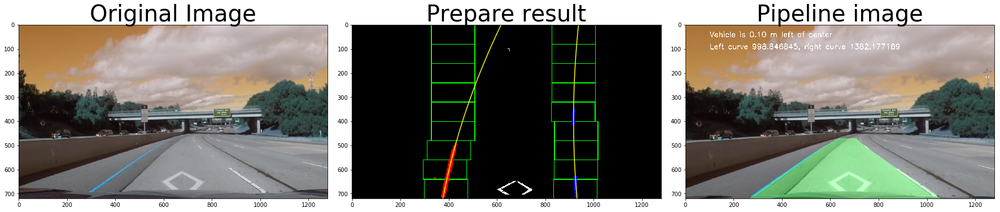

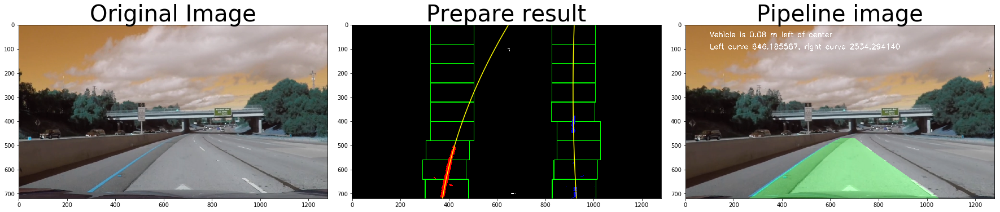

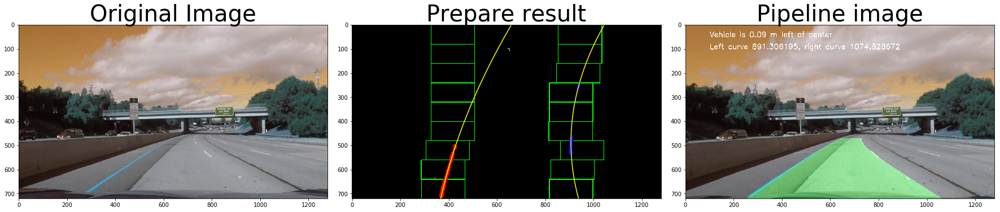

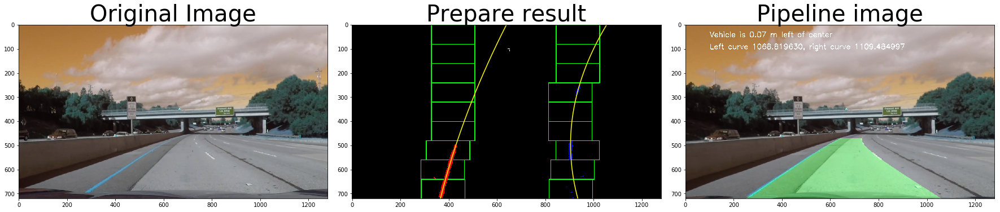

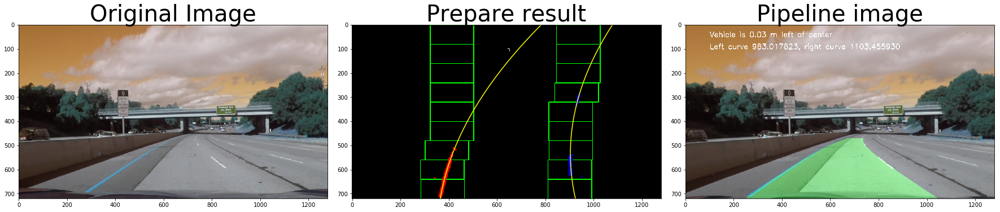

...

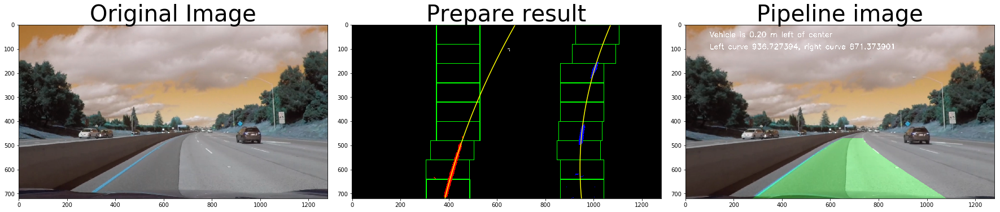

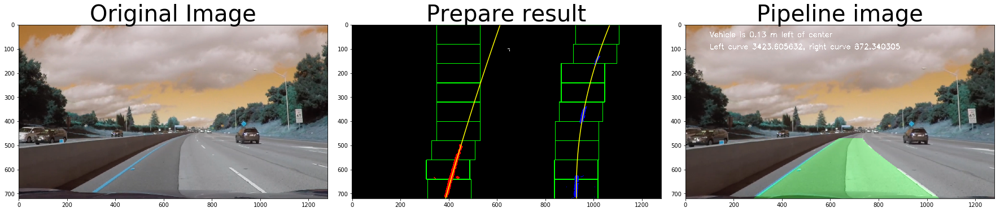

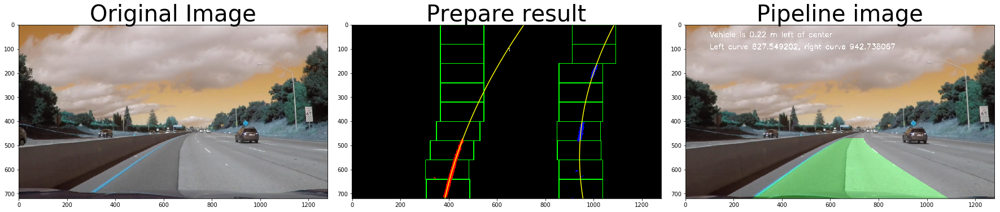

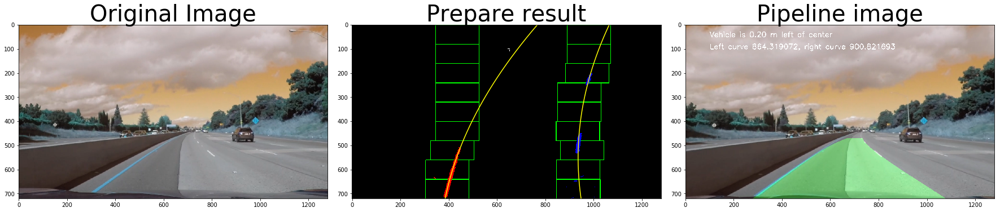

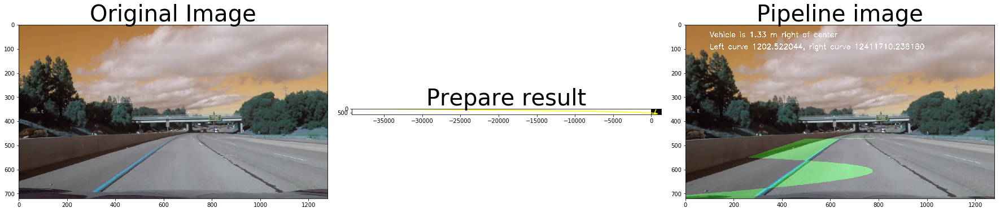

In [113]:
y_len=720
ploty = np.linspace(0, y_len-1, y_len)

for i in range(1,15):
    fname = './test_images/Screenshot from challenge_video.mp4 - {}.png'.format(i)
    image = cv2.imread(fname)
    image= cv2.resize(image, (1280, 720)) 
    
    result = prepare(image)
    _, _, left_fitx, right_fitx, out_img=  blind_search(result)  
    
    # Plot the result
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=40)

    ax2.imshow(out_img)
    ax2.plot(left_fitx, ploty, color='yellow')
    ax2.plot(right_fitx, ploty, color='yellow')
    ax2.set_title('Prepare result', fontsize=40)
 

    ax3.imshow(pipeline(image))
    ax3.set_title('Pipeline image', fontsize=40)
   
   
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [128]:
project_output = './challenge_video_result_normal.mp4'
#clip1 = VideoFileClip("./challenge_video.mp4")
#project_clip = clip1.fl_image(pipeline) #NOTE: this function expects color images!!
#%time project_clip.write_videofile(project_output, audio=False)

In [129]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))

In [126]:
#reset lines
left_lane=Line()
right_lane=Line()

project_output = './challenge_video_result_advanced.mp4'
#clip1 = VideoFileClip("./challenge_video.mp4")
#project_clip = clip1.fl_image(advanced_pipeline) #NOTE: this function expects color images!!
#%time project_clip.write_videofile(project_output, audio=False)

In [125]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))

## Afterthoughts

Many paramters have to be tuned patiently for the pipelines to give satisfactory results. The advanced pipeline works better by sanity checks, look ahead filter, and smoothing. However, it requires more computation power. 

Shadows and steep curves are the hardest to deal with because region masking is no longer sufficient to eliminate noises while preserving lanes. Moreover, shadows shortens true lanes and cast false positives to the binary image. This issue is critical because in the harder video where tight curves and shadows or bright areas casted by the trees exists, it becomes tedious to add more filters and tune them to suit the condition. Also, shrubs around the lane can often trick the lane finder. One possible way is to automate the tuning process in which we rank numerous possible solutions given by several parameter sets. Another is to teach a neural net to assist the lanefinding.

Multiple or better cameras can be used to minimize shadowing effect. 

The sanity check can be added with intersection check and to sort out the wrong lane. 

